In [ ]:
import matplotlib.pyplot as plt
import numpy as np

xpoints = np.array([1, 8])
ypoints = np.array([3, 10])

plt.plot(xpoints, ypoints)
# plt.show()

plt.savefig("image.png")

Generating agent traits...

Player:1, Age:67, Gender:Female, Physical:55, Charisma:61, Obedience:64, Revenge tendency:80, Trust voting:93, Similarity bias:52, Charisma bias:90, Indecisiveness:40.0, Morals:45, Aggression:80
Player:2, Age:61, Gender:Male, Physical:73, Charisma:88, Obedience:77, Revenge tendency:65, Trust voting:83, Similarity bias:75, Charisma bias:72, Indecisiveness:3.5, Morals:47, Aggression:63
Player:3, Age:41, Gender:Female, Physical:82, Charisma:79, Obedience:54, Revenge tendency:67, Trust voting:89, Similarity bias:67, Charisma bias:98, Indecisiveness:32.0, Morals:25, Aggression:60
Player:4, Age:24, Gender:Male, Physical:98, Charisma:76, Obedience:72, Revenge tendency:55, Trust voting:61, Similarity bias:88, Charisma bias:99, Indecisiveness:45.0, Morals:93, Aggression:83
Player:5, Age:21, Gender:Male, Physical:27, Charisma:71, Obedience:69, Revenge tendency:83, Trust voting:58, Similarity bias:70, Charisma bias:97, Indecisiveness:27.5, Morals:10, Aggression:59

Rou

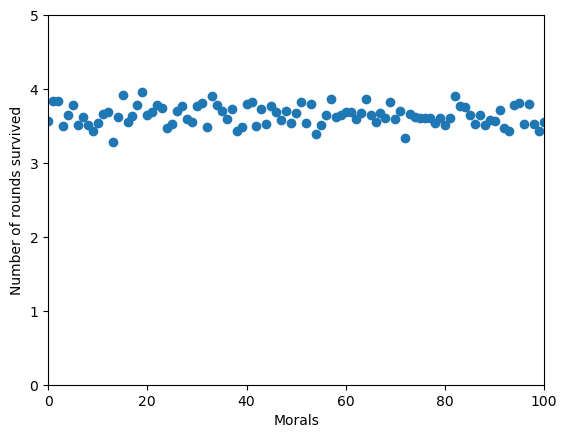

In [15]:
import matplotlib.pyplot as plt
import numpy as np
import random
import time

class Agent:
  def __init__(self, id, age, gender, physical, charisma, obedience, revenge_tendency, trust_voting, similarity_bias, charisma_bias, indecisiveness, morals, aggression): # all traits 1-100
    self.id = id

    self.age = age
    self.gender = gender

    self.physical = physical # dicates who wins

    self.charisma = charisma # more likely for others to follow your vote
    self.obedience = obedience # more likely to vote for majority rather than the player with the lowest relationship strength
    self.revenge_tendency = revenge_tendency # more likely to vote for someone who voted for you (50-100)
    self.trust_voting = trust_voting # % of trust voting

    self.similarity_bias = similarity_bias # (50-100)
    self.charisma_bias = charisma_bias

    self.indecisiveness = indecisiveness/2 # (0-50)

    # Obedience is 65%, revenge tendency is 15%, similarity bias is 10%, charisma is 10%

    # 3 people have voted, 2 people have voted for P1 while 1 person has voted for you

    self.morals = morals

    self.aggression = aggression

    self.trust = 70 # decreases by 15 every time someone votes for you (TBD)

    self.relationships = [] # every player will be in the format {"player":player, "trust":value, "similarity":value}

  def calc_similarity(self, player):
    # age and gender = 35%
    # morals = 65%

    # trust 70%
    # morals 30%

    age_diff = abs(self.age - player.age)
    moral_diff = abs(self.morals - player.morals)

    if self.gender == player.gender:
      gender_diff = 0

    else:
      gender_diff = 15

    similarity = 100 - 1.2 * (0.35 * (age_diff + gender_diff) + 0.65 * moral_diff)

    return similarity
  
  def calc_trust_voting(self):
    players = []
    values = []

    for relationship in self.relationships:
      trust = relationship["trust"]
      morals = relationship["player"].morals

      values.append(0.8 * trust + 0.2 * morals)
      players.append(relationship["player"])

    index = values.index(min(values))

    return players[index]
  
  def calc_relationship(self, player):
    for relationship in self.relationships:
      if relationship["player"] == player:
        break

    strength = 0.65 * relationship["trust"] + 0.35 * self.calc_similarity(player)

    return strength
  
  def make_relationships(self, players):
    for player in players:
      if self.id != player.id:
        self.relationships.append({
          "player": player,
          "trust": player.trust,
          "similarity": self.calc_similarity(player),
        })

  def log_relationship(self, player, trust, similarity):
    for relationship in self.relationships:
      if relationship["player"] == player.id:
        self.relationships["trust"] == trust
        self.relationships["similarity"] == similarity

        return
      
  def update_trust(self, player, change):
    for relationship in self.relationships:
      if relationship["player"] == player.id:
        self.relationships["trust"] += change

        return
      
class Round:
  def __init__(self, agents, round_num, time):
    self.agents = agents
    self.voting = [] # {"player":player, "votes":[p2, p3], "voted_for":player}
    
    self.round_num = round_num

    self.time = time

    for agent in agents:
      self.voting.append({"player":agent, "votes":[], "voted_for":None})

  def vote(self, p1, p2): # p1 votes for p2
    for agent in self.voting:
      if agent["player"] == p2:
        agent["votes"].append(p1)

      if agent["player"] == p1:
        agent["voted_for"] = p2

    for relationship in p2.relationships:
      if relationship["player"] == p1:
        relationship["trust"] -= 30

        if relationship["trust"] < 0:
          relationship["trust"] = 0

    self.has_voted.append(p1)

    # time.sleep(3 * (1+p1.indecisiveness/100)) # minimum is three seconds
      
  def count_majority(self):
    agents = []
    votes = []

    for agent in self.voting:
      agents.append(agent["player"])
      votes.append(len(agent["votes"]))

    for vote in votes:
      index = votes.index(max(votes))

    return agents[index]
  
  def eliminate(self, player):
    self.agents.remove(player)

  def create_all_relationships(self): # for every player
    for player in self.agents:
      player.make_relationships(self.agents)

  def get_revenge(self, player): # {"player":player, "votes":[p2, p3]}
    targets = []

    for agent in self.voting:
      if agent["player"] == player:
        return agent["votes"]
  
  def get_charisma(self, player):
    weights = []
    population = []

    for agent in self.agents:
      if agent != player:
        weights.append(agent.charisma)

    weights = sorted(weights)

    for weight in weights:
      for agent in self.agents:
        if agent != player:
          if agent.charisma == weight:
            population.append(agent)

            break

    if len(weights) >= 3: # give extra weights to top 3 agents with high charisma
      weights[-1] *= 2
      weights[-2] *= 1.5
      weights[-3] *= 1.2

    choice = random.choices(population=population, weights=weights)

    return choice[0] # since choice is in [choice] format, use choice[0] to exclude the list
  
  def get_fighter(self):
    weights = []
    population = []

    for agent in self.agents:
      weights.append(agent.aggression)

    weights = sorted(weights)

    for weight in weights:
      for agent in self.agents:
        if agent.aggression == weight:
          population.append(agent)

          break

    if len(weights) >= 3: # give extra weights to top 3 agents with high charisma
      weights[-1] *= 2
      weights[-2] *= 1.5
      weights[-3] *= 1.2

    choice = random.choices(population=population, weights=weights)

    return choice[0] # since choice is in [choice] format, use choice[0] to exclude the list
  
  def get_victim(self):
    return random.choice(self.agents)

  def round(self):
    self.create_all_relationships()

    players = self.agents
    random.shuffle(players) # shuffles the order in which they go

    start = time.time()
    end = time.time()

    self.has_voted = []

    print("The players have agreed to a democratic vote.")

    while end - start < self.time:
      for i, player in enumerate(players):
        relationships = []
        relationship_strengths = []

        for relationship in player.relationships:
          if relationship["player"] in self.agents:
            relationships.append(relationship["player"])
            relationship_strengths.append(player.calc_relationship(relationship["player"]))

        index = relationship_strengths.index(min(relationship_strengths))
        target = relationships[index]

        fight = False

        end = time.time()

        if end - start >= self.time * 2/3: # check if fight should happen
          chance = random.random()

          if chance <= 50:
            fight = True

            break

        if end - start >= self.time * 4/5:
          chance = random.random

          if chance <= 95:
            fight = True

            break

        if i == 0 and self.round_num == 1: # check if player is first to vote
          self.vote(player, target)

          print(f"Player {player.id} has voted for Player {target.id} due to their lack of similarity")

        else:
          was_voted = False

          for agent in self.voting:
            if agent == player:
              if len(agent["votes"]) > 0:
                was_voted = True

                break
          
          if player == self.count_majority(): # revenge 40% trust voting 40% similarity 20%
            # formula = random.choices(population=["P1","P2"], weights=[80*(1-(avg-value))])
            choice = random.choices(population=["revenge","trust", "similarity"], weights=[40*(1-(75-player.revenge_tendency)/100), 40*(1-(75-player.trust_voting)/100), 20*(1-(75-player.similarity_bias)/100)])
            
            if choice[0] == "revenge" and was_voted: # selected revenge 
              targets = self.get_revenge(player)
              target = random.choice(targets)

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} as an act of revenge")

            elif choice[0] == "trust":
              target = player.calc_trust_voting()

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} due to a lack of trust and morals")

            else: # similarity selected
              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} due to their lack of similarity")

          else:
            follower = self.get_charisma(player)

            has_voted = follower in self.has_voted

            for vote in self.voting:
              if vote["player"] == follower:
                charisma_target = vote["voted_for"]

            if was_voted:
              if has_voted and (player != charisma_target):
                choice = random.choices(population=["obedience","trust","revenge","similarity","charisma"], weights=[35*(1-(75-player.obedience)/100), 35*(1-(75-player.trust_voting)/100), 15*(1-(75-player.revenge_tendency)/100), 5*(1-(75-player.similarity_bias)/100), 10*(1-(75-player.charisma_bias)/100)])

              else:
                choice = random.choices(population=["obedience","trust","revenge","similarity"], weights=[35*(1-(75-player.obedience)/100), 35*(1-(75-player.trust_voting)/100), 20*(1-(75-player.revenge_tendency)/100), 10*(1-(75-player.similarity_bias)/100)])

            else:
              if has_voted and (player != charisma_target):
                choice = random.choices(population=["obedience","trust","similarity","charisma"], weights=[35*(1-(75-player.obedience)/100), 35*(1-(75-player.trust_voting)/100), 15*(1-(75-player.similarity_bias)/100), 15*(1-(75-player.charisma_bias)/100)])

              else:
                choice = random.choices(population=["obedience","trust","similarity"], weights=[40*(1-(75-player.obedience)/100), 40*(1-(75-player.trust_voting)/100), 20*(1-(75-player.similarity_bias)/100)])
            
            if choice[0] == "obedience":
              target = self.count_majority()

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} to follow the majority vote")

            elif choice[0] == "revenge":
              targets = self.get_revenge(player)
              target = random.choice(targets)

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} as an act of revenge")

            elif choice[0] == "trust":
              target = player.calc_trust_voting()

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} due to a lack of trust and morals")

            elif choice[0] == "similarity": # similarity bias selected
              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} due to their lack of similarity")

            else: # charisma bias selected
              for vote in self.voting:
                if vote["player"] == follower:
                  target = vote["voted_for"]

              self.vote(player, target)

              print(f"Player {player.id} has voted for Player {target.id} due to a high charismatic player voting for the same person")

      if i+1 == len(players): # every player has voted
        player = self.count_majority() # majority player

        self.eliminate(player)

        print(f"Player {player.id} has been eliminated as the majority of the vote")

        self.survivors = self.agents

        return

      elif fight:
        fighter = self.get_fighter()
        victim = self.get_victim()

        if fighter.physical >= victim.physical:
          self.eliminate(victim)

          print(f"Player {victim.id} has been pushed off by Player {fighter.id} in a fight")

          for agent in self.agents:
            if agent != fighter:
              for relationship in agent.relationships:
                if relationship["player"] == fighter:
                  relationship["trust"] -= 25

          self.survivors = self.agents

          return

        else:
          self.eliminate(fighter)

          print(f"Player {fighter.id} has been pushed off by Player {victim.id} in a fight")

          self.survivors = self.agents

          return

      end = time.time()

    if len(players) == len(self.agents): # no players were eliminated within time
      for agent in self.agents:
        self.eliminate(agent) # every player ends up eliminated
        
        print(f"Player {agent.id} has been eliminated")

        self.survivors = self.agents

        return

# players = []
# id = 1

# print("Generating agent traits...\n")

# time.sleep(0.3)

# for i in range(10):
#   # id, age, gender, physical, charisma, obedience, revenge_tendency, similarity_bias, charisma_bias, indecisiveness, morals, aggression

#   age = random.randint(18, 70)
#   gender = random.choice(["Male", "Female"])

#   physical = random.randint(20, 100)

#   charisma = random.randint(50, 100)
#   obedience = random.randint(50, 100)
#   revenge_tendency = random.randint(50, 100)
#   trust_voting = random.randint(50, 100)
#   similarity_bias = random.randint(50, 100)
#   charisma_bias = random.randint(50, 100)

#   indecisiveness = random.randint(1, 100)
  
#   morals = random.randint(1, 100)

#   aggression = random.randint(1, 100)

#   player = Agent(id, age, gender, physical, charisma, obedience, revenge_tendency, trust_voting, similarity_bias, charisma_bias, indecisiveness, morals, aggression)
#   players.append(player)

#   print(f"Player:{player.id}, Age:{player.age}, Gender:{player.gender}, Physical:{player.physical}, Charisma:{player.charisma}, Obedience:{player.obedience}, Revenge tendency:{player.revenge_tendency}, Trust voting:{player.trust_voting}, Similarity bias:{player.similarity_bias}, Charisma bias:{player.charisma_bias}, Indecisiveness:{player.indecisiveness}, Morals:{player.morals}, Aggression:{player.aggression}")

#   id += 1

#   time.sleep(0.5)

# survivors = players
# game_time = 100

# for i in range(7):
#   print(f"\nRound {i+1} starting...\n")  

#   game = Round(players, i+1, game_time)
#   game.round()

#   survivors = game.survivors
#   game_time -= 5

# winners = []

# for i in winners:
#   winners.append(i.id)

# print(", ".join(winners))

players = []

print("Generating agent traits...\n")

# time.sleep(0.3)

obedience_scores = []
survival_scores = []

for score_interval in range(0, 101, 1):
  scores = []

  for i in range(100):
    id = 1
    players = []

    for i in range(5):
      age = random.randint(18, 70)
      gender = random.choice(["Male", "Female"])

      physical = random.randint(20, 100)

      charisma = random.randint(50, 100)
      obedience = random.randint(50, 100)
      revenge_tendency = random.randint(50, 100)
      trust_voting = random.randint(50, 100)
      similarity_bias = random.randint(50, 100)
      charisma_bias = random.randint(50, 100)

      indecisiveness = random.randint(1, 100)
      
      morals = random.randint(1, 100)

      aggression = random.randint(1, 100)

      player = Agent(id, age, gender, physical, charisma, obedience, revenge_tendency, trust_voting, similarity_bias, charisma_bias, indecisiveness, morals, aggression)
      players.append(player)

      print(f"Player:{player.id}, Age:{player.age}, Gender:{player.gender}, Physical:{player.physical}, Charisma:{player.charisma}, Obedience:{player.obedience}, Revenge tendency:{player.revenge_tendency}, Trust voting:{player.trust_voting}, Similarity bias:{player.similarity_bias}, Charisma bias:{player.charisma_bias}, Indecisiveness:{player.indecisiveness}, Morals:{player.morals}, Aggression:{player.aggression}")

      id += 1

      # time.sleep(0.5)

    agent = Agent(1000, 40, "Male", 60, 75, 75, score_interval, 75, 75, 75, 50, 50, 50)
    players.append(agent)

    survivors = players
    game_time = 100

    for i in range(5):
      print(f"\nRound {i+1} starting...\n")  

      game = Round(survivors, i+1, game_time)
      game.round()

      survivors = game.survivors
      game_time -= 5

      score = i+1

      if not(agent in survivors):
        scores.append(score)

        break

      # elif i == 4:
      #   score = 100

      #   break

  avg_score = sum(scores)/len(scores)

  obedience_scores.append(score_interval)
  survival_scores.append(avg_score)
  
x = np.array(obedience_scores)
y = np.array(survival_scores)

plt.xlabel("Morals")
plt.ylabel("Number of rounds survived")

plt.xlim([0, 100])
plt.ylim([0, 5])

plt.scatter(x, y)

plt.show()